## Classification on Imbalanced Data

This tutorial demonstrates how to classify a highly imbalanced dataset in which the number of examples in one class greatly outnumbers the examples in another. You will work with the <em>Credit Card Fraud Detection dataset hosted on Kaggle</em>. The aim is to detect a mere <em>492 fraudulent transactions from 284,807 transactions</em> in total. 

This tutorial contains complete code to:
* Load a CSV file using Pandas.
* Create train, validation, and test sets.
* Define and train a model using Keras (including setting class weights).
* Evaluate the model using various metrics (including precision and recall).
* Try common tecniques for dealing with imbalanced data like: 
* Class weighting 
* Oversampling

In [2]:
## Library imports

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import tensorflow as tf

In [3]:
# Note this code is only valid if GPU is being used for training

# Before we run the parameter tuning, we will work with little gpu memory allocation
# we will only use that much of memory of gpu as it is needed - allow the growth of gpu memory as it is needed

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)

### Load the dataset

In [4]:
df = pd.read_csv('https://storage.googleapis.com/download.tensorflow.org/data/creditcard.csv')

# verify the load
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [5]:
# Check the data structure
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [6]:
# Check for missing values
sum(df.isna().sum())

0

### Data Exploration and Preparation

<AxesSubplot:xlabel='Class', ylabel='count'>

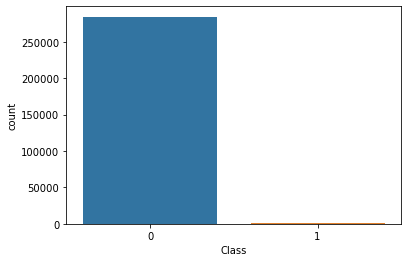

In [7]:
# Lets visualize the target variable
sns.countplot(x='Class',  data=df)

In [8]:
# The proportion of frauds in the whole dataset
print("The total fraud is %0.4f - %f percent of whole dataset" %(df['Class'].value_counts()[1]/len(df), 
                                                        df['Class'].value_counts()[1]/len(df) * 100))

The total fraud is 0.0017 - 0.172749 percent of whole dataset


In [9]:
# We dont need the time column
df.drop(labels=['Time'], axis=1, inplace=True)

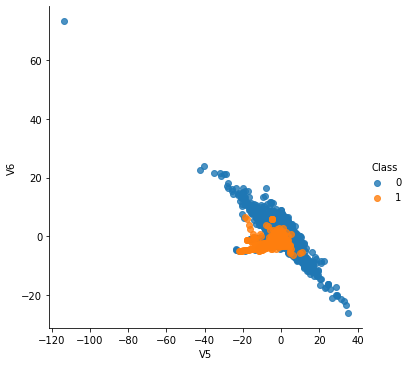

In [10]:
# We will do a simple lmplot between two parameters V5 and V6

sns.lmplot(x='V5', y='V6', hue='Class', data=df, fit_reg=False)

This actually shows that for parameters V5 and V6, the fraudulent transactions are very similar to each other

In [11]:
# the Amount column, seems to have a large variation
df['Amount'].describe()

count    284807.000000
mean         88.349619
std         250.120109
min           0.000000
25%           5.600000
50%          22.000000
75%          77.165000
max       25691.160000
Name: Amount, dtype: float64

In [12]:
# We will introduce a log of this column, use the column in modelling and drop the original Amount column
# However in order to do this, there are some values with 0 in Amount and Log(0) is infinity and hence we add a very small
# negligible amount to the log to avoid this infinity error
adjustments = 0.001
df['Log Amount'] = np.log(df['Amount'] + adjustments)

df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V22,V23,V24,V25,V26,V27,V28,Amount,Class,Log Amount
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0,5.008105
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0,0.989913
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0,5.936641
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0,4.816249
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0,4.248367


<Figure size 864x720 with 0 Axes>

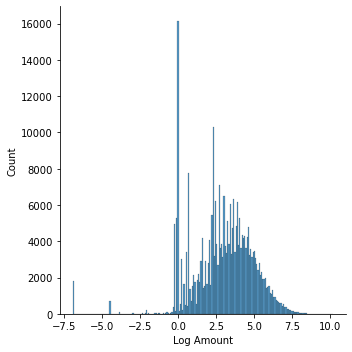

In [13]:
# Now visualizing the Log Amount
plt.figure(figsize=(12,10))
sns.displot(x='Log Amount', data=df)

In [14]:
# Dropping the Amount column
df.drop(labels=['Amount'], axis=1, inplace=True)

In [15]:
df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Class,Log Amount
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,0,5.008105
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0,0.989913
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,0,5.936641
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,0,4.816249
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,0,4.248367


### Perform train, test and validation splits

* Split the dataset into train, validation, and test sets. The validation set is used during the model fitting to evaluate the loss and any metrics, however the model is not fit with this data. 
* The test set is completely unused during the training phase and is only used at the end to evaluate how well the model generalizes to new data. 
* This is especially important with imbalanced datasets where overfitting is a significant concern from the lack of training data.

In [16]:
# Isolate the features and target variable

features = df.drop(labels=['Class'], axis=1).values
target = df['Class'].values

In [17]:
# Perform the standardisation

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
features = sc.fit_transform(features)
features

array([[-0.69424232, -0.04407492,  1.6727735 , ...,  0.33089162,
        -0.06378115,  1.02091976],
       [ 0.60849633,  0.16117592,  0.1097971 , ..., -0.02225568,
         0.04460752, -0.96466543],
       [-0.69350046, -0.81157783,  1.16946849, ..., -0.13713686,
        -0.18102083,  1.47975471],
       ...,
       [ 0.98002374, -0.18243372, -2.14320514, ...,  0.01103672,
        -0.0804672 ,  0.63036959],
       [-0.12275539,  0.32125034,  0.46332013, ...,  0.26960398,
         0.31668678, -0.31596056],
       [-0.27233093, -0.11489898,  0.46386564, ..., -0.00598394,
         0.04134999,  1.20464259]])

In [18]:
### Perform the splits

from sklearn.model_selection import train_test_split
features_train, features_test, target_train, target_test = train_test_split(features, target, test_size=0.2, 
                                                                            random_state=101)

features_train, features_validation, target_train, target_validation = train_test_split(features_train, target_train,
                                                                                        test_size=0.2, random_state=101)

In [19]:
print("Training Features shape: ", features_train.shape)
print("Training Target shape: ", target_train.shape)

print("Validation Features shape: ", features_validation.shape)
print("Validation Target shape: ", target_validation.shape)

print("Test Features shape: ", features_test.shape)
print("Training Target shape: ", target_test.shape)

Training Features shape:  (182276, 29)
Training Target shape:  (182276,)
Validation Features shape:  (45569, 29)
Validation Target shape:  (45569,)
Test Features shape:  (56962, 29)
Training Target shape:  (56962,)


### Build and Train the Model

In [20]:
# Lets define the metrics list

METRICS = [tf.keras.metrics.TruePositives(name='tp'),
          tf.keras.metrics.FalsePositives(name='fp'),
          tf.keras.metrics.TrueNegatives(name='tn'),
          tf.keras.metrics.FalseNegatives(name='fn'), 
          tf.keras.metrics.BinaryAccuracy(name='accuracy'),
          tf.keras.metrics.Precision(name='precision'),
          tf.keras.metrics.Recall(name='recall'),
          tf.keras.metrics.AUC(name='auc')]

# Model Constants
INPUT_SHAPE = (features_train.shape[1],)
HIDDEN_UNITS = 16
OUTPUT_UNITS = 1
ACTIVATION_HIDDEN = tf.keras.activations.relu
ACTIVATION_OUTPUT = tf.keras.activations.sigmoid
DROPOUT_RATE = 0.5
LEARNING_RATE = 1e-3
OPTIMIZER = tf.keras.optimizers.Adam(LEARNING_RATE)
LOSS_FUNCTION = tf.keras.losses.BinaryCrossentropy()

EPOCHS = 100
BATCH_SIZE = 2048

Model is fit using a larger than default batch size of 2048, this is important to ensure that each batch has a decent chance of containing a few positive samples. If the batch size was too small, they would likely have no fraudulent transactions to learn from.

In [21]:
# Function which will build and compile the model

def make_model(metrics=METRICS, output_bias=None):
    if output_bias is not None:
        output_bias = tf.keras.initializers.Constant(output_bias)
    model = tf.keras.models.Sequential([
           tf.keras.layers.Dense(input_shape=INPUT_SHAPE, units=HIDDEN_UNITS, activation=ACTIVATION_HIDDEN),
           tf.keras.layers.Dropout(DROPOUT_RATE),
           tf.keras.layers.Dense(units=OUTPUT_UNITS, activation=ACTIVATION_OUTPUT, bias_initializer=output_bias)
       ])
    model.compile(optimizer=OPTIMIZER, loss=LOSS_FUNCTION, metrics=metrics)
    return model

#### Understanding Useful Metrics

Note that there are a few metrics defined below that can be computed by the model that will be helpful when evaluating the performance.

<img src="resources/classification-metrics.png" length=800 width=800>

In [22]:
# Lets build the model and see the model summary

model = make_model()
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16)                480       
_________________________________________________________________
dropout (Dropout)            (None, 16)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 497
Trainable params: 497
Non-trainable params: 0
_________________________________________________________________


In [23]:
# We will now fit the model on the training data and validation data

epochs_history = model.fit(features_train, target_train, batch_size=BATCH_SIZE, epochs=EPOCHS,
                          validation_data=(features_validation, target_validation),
                          verbose=1)

0.9174
Epoch 50/100
90/90 [==============================] - 0s 3ms/step - loss: 0.0049 - tp: 157.0000 - fp: 24.0000 - tn: 181942.0000 - fn: 153.0000 - accuracy: 0.9990 - precision: 0.8674 - recall: 0.5065 - auc: 0.9496 - val_loss: 0.0045 - val_tp: 45.0000 - val_fp: 5.0000 - val_tn: 45485.0000 - val_fn: 34.0000 - val_accuracy: 0.9991 - val_precision: 0.9000 - val_recall: 0.5696 - val_auc: 0.9174
Epoch 51/100
90/90 [==============================] - 0s 3ms/step - loss: 0.0048 - tp: 170.0000 - fp: 27.0000 - tn: 181939.0000 - fn: 140.0000 - accuracy: 0.9991 - precision: 0.8629 - recall: 0.5484 - auc: 0.9480 - val_loss: 0.0045 - val_tp: 50.0000 - val_fp: 5.0000 - val_tn: 45485.0000 - val_fn: 29.0000 - val_accuracy: 0.9993 - val_precision: 0.9091 - val_recall: 0.6329 - val_auc: 0.9174
Epoch 52/100
90/90 [==============================] - 0s 3ms/step - loss: 0.0048 - tp: 164.0000 - fp: 28.0000 - tn: 181938.0000 - fn: 146.0000 - accuracy: 0.9990 - precision: 0.8542 - recall: 0.5290 - auc: 0.9

### Model Validation

In [24]:
# Let us run the predictions

target_predictions = model.predict(features_test)

In [25]:
# Let us visualize the Confusion Matrix and detail out some key metrices including classification report

from sklearn.metrics import confusion_matrix, classification_report, f1_score, accuracy_score, balanced_accuracy_score

def plot_cm(labels, predictions, threshold=0.5):
    cm = confusion_matrix(labels, predictions > threshold)
    plt.figure(figsize=(5, 5))
    sns.heatmap(cm, annot=True, fmt="d")
    plt.title("Confusion Matrix %0.2f" %threshold)
    plt.xlabel("Predicted Label")
    plt.ylabel("Actual Label")
    
    print('Legitimate Transactions Detected (True Negatives): ', cm[0][0])
    print('Legitimate Transactions Incorrectly Detected (False Positives): ', cm[0][1])
    print('Fraudulent Transactions Missed (False Negatives): ', cm[1][0])
    print('Fraudulent Transactions Detected (True Positives): ', cm[1][1])
    print('Total Fraudulent Transactions: ', np.sum(cm[1]))
    print("\n")
    print("F1-Score")
    print(f1_score(target_test, target_predictions > 0.5))
    print("\n")
    print("Classification Report")
    print(classification_report(target_test, target_predictions > 0.5))

Legitimate Transactions Detected (True Negatives):  56855
Legitimate Transactions Incorrectly Detected (False Positives):  4
Fraudulent Transactions Missed (False Negatives):  39
Fraudulent Transactions Detected (True Positives):  64
Total Fraudulent Transactions:  103


F1-Score
0.7485380116959063


Classification Report
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56859
           1       0.94      0.62      0.75       103

    accuracy                           1.00     56962
   macro avg       0.97      0.81      0.87     56962
weighted avg       1.00      1.00      1.00     56962



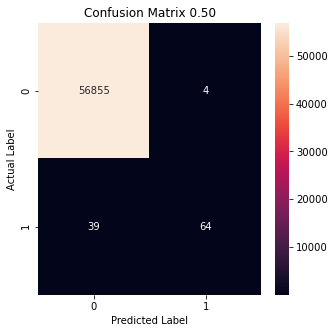

In [26]:
# Now use the function to plot the confusion matrix
plot_cm (target_test, target_predictions)

### Tuning and Re-validation